This notebook is studying more on causal graphs of student's performance n exams based on influence of the parents background, test preparation etc.

In [1]:
import pandas as pd
import numpy as np

In [2]:
data = pd.read_csv('data/student-por.csv', delimiter=',')
data.head(15)

,school,sex,age,address,famsize,Pstatus,Medu,Fedu,Mjob,Fjob,...,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3
0,GP,F,18,U,GT3,A,4,4,at_home,teacher,...,4,3,4,1,1,3,4,0,11,11
1,GP,F,17,U,GT3,T,1,1,at_home,other,...,5,3,3,1,1,3,2,9,11,11
2,GP,F,15,U,LE3,T,1,1,at_home,other,...,4,3,2,2,3,3,6,12,13,12
3,GP,F,15,U,GT3,T,4,2,health,services,...,3,2,2,1,1,5,0,14,14,14
4,GP,F,16,U,GT3,T,3,3,other,other,...,4,3,2,1,2,5,0,11,13,13
5,GP,M,16,U,LE3,T,4,3,services,other,...,5,4,2,1,2,5,6,12,12,13
6,GP,M,16,U,LE3,T,2,2,other,other,...,4,4,4,1,1,3,0,13,12,13
7,GP,F,17,U,GT3,A,4,4,other,teacher,...,4,1,4,1,1,1,2,10,13,13
8,GP,M,15,U,LE3,A,3,2,services,other,...,4,2,2,1,1,1,0,15,16,17
9,GP,M,15,U,GT3,T,3,4,other,other,...,5,5,1,1,1,5,0,12,12,13


In [3]:
data.to_csv('data/std-poor.csv')
data.columns

Index(['school', 'sex', 'age', 'address', 'famsize', 'Pstatus', 'Medu', 'Fedu',
       'Mjob', 'Fjob', 'reason', 'guardian', 'traveltime', 'studytime',
       'failures', 'schoolsup', 'famsup', 'paid', 'activities', 'nursery',
       'higher', 'internet', 'romantic', 'famrel', 'freetime', 'goout', 'Dalc',
       'Walc', 'health', 'absences', 'G1', 'G2', 'G3'],
      dtype='object')

In [4]:
import warnings
warnings.filterwarnings("ignore")

from causalnex.structure import StructureModel
sm = StructureModel()

In [5]:
sm.add_edges_from([
    ('health', 'absences'),
    ('health', 'G1')
])

In [6]:
sm.edges


OutEdgeView([('health', 'absences'), ('health', 'G1')])

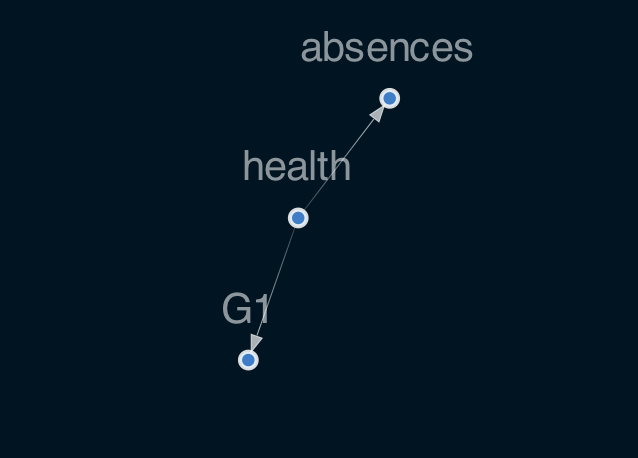

In [7]:
from IPython.display import Image
from causalnex.plots import plot_structure, NODE_STYLE, EDGE_STYLE

viz = plot_structure(
    sm,
    graph_attributes={"scale": "0.5"},
    all_node_attributes=NODE_STYLE.WEAK,
    all_edge_attributes=EDGE_STYLE.WEAK)
Image(viz.draw(format='png'))

In [8]:
drop_col = ['school','sex','age','Mjob', 'Fjob','reason','guardian']
data = data.drop(columns=drop_col)
data.head(5)

,address,famsize,Pstatus,Medu,Fedu,traveltime,studytime,failures,schoolsup,famsup,...,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3
0,U,GT3,A,4,4,2,2,0,yes,no,...,4,3,4,1,1,3,4,0,11,11
1,U,GT3,T,1,1,1,2,0,no,yes,...,5,3,3,1,1,3,2,9,11,11
2,U,LE3,T,1,1,1,2,0,yes,no,...,4,3,2,2,3,3,6,12,13,12
3,U,GT3,T,4,2,1,3,0,no,yes,...,3,2,2,1,1,5,0,14,14,14
4,U,GT3,T,3,3,1,2,0,no,yes,...,4,3,2,1,2,5,0,11,13,13


In [9]:
struct_data = data.copy()

non_numeric_columns = list(struct_data.select_dtypes(exclude=[np.number]).columns)
print(non_numeric_columns)
struct_data = data.copy()

non_numeric_columns = list(struct_data.select_dtypes(exclude=[np.number]).columns)
print(non_numeric_columns)

['address', 'famsize', 'Pstatus', 'schoolsup', 'famsup', 'paid', 'activities', 'nursery', 'higher', 'internet', 'romantic']
['address', 'famsize', 'Pstatus', 'schoolsup', 'famsup', 'paid', 'activities', 'nursery', 'higher', 'internet', 'romantic']


In [10]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()
for col in non_numeric_columns:
    struct_data[col] = le.fit_transform(struct_data[col])

struct_data.head(5)

,address,famsize,Pstatus,Medu,Fedu,traveltime,studytime,failures,schoolsup,famsup,...,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3
0,1,0,0,4,4,2,2,0,1,0,...,4,3,4,1,1,3,4,0,11,11
1,1,0,1,1,1,1,2,0,0,1,...,5,3,3,1,1,3,2,9,11,11
2,1,1,1,1,1,1,2,0,1,0,...,4,3,2,2,3,3,6,12,13,12
3,1,0,1,4,2,1,3,0,0,1,...,3,2,2,1,1,5,0,14,14,14
4,1,0,1,3,3,1,2,0,0,1,...,4,3,2,1,2,5,0,11,13,13


In [11]:
from causalnex.structure.notears import from_pandas
sm = from_pandas(struct_data)

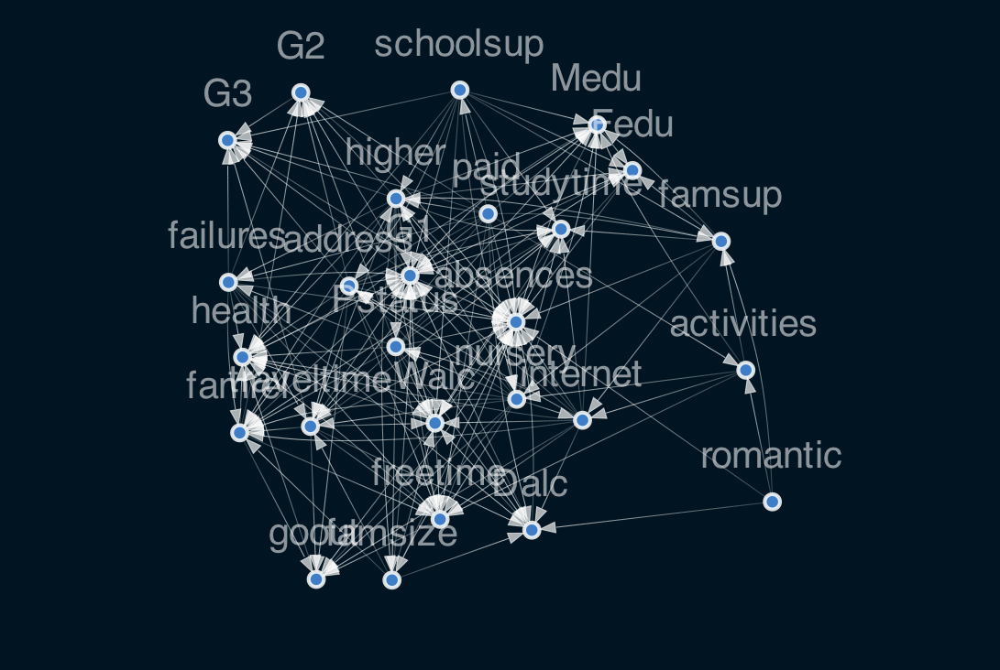

In [12]:
sm.remove_edges_below_threshold(.1)
viz = plot_structure(
    sm,
    graph_attributes={"scale": "0.5"},
    all_node_attributes=NODE_STYLE.WEAK,
    all_edge_attributes=EDGE_STYLE.WEAK)
Image(viz.draw(format='png'))

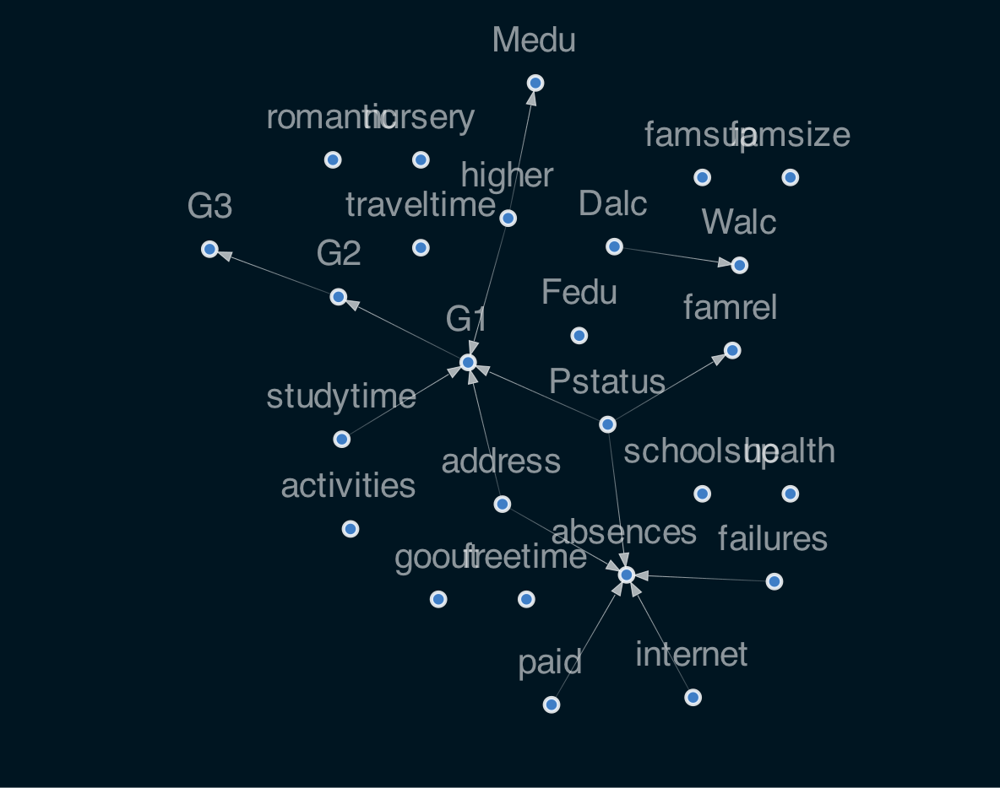

In [13]:
sm.remove_edges_below_threshold(0.8)
viz = plot_structure(
    sm,
    graph_attributes={"scale": "0.5"},
    all_node_attributes=NODE_STYLE.WEAK,
    all_edge_attributes=EDGE_STYLE.WEAK)
Image(viz.draw(format='png'))

In [14]:
sm = from_pandas(struct_data, tabu_edges=[("higher", "Medu")], w_threshold=0.8)


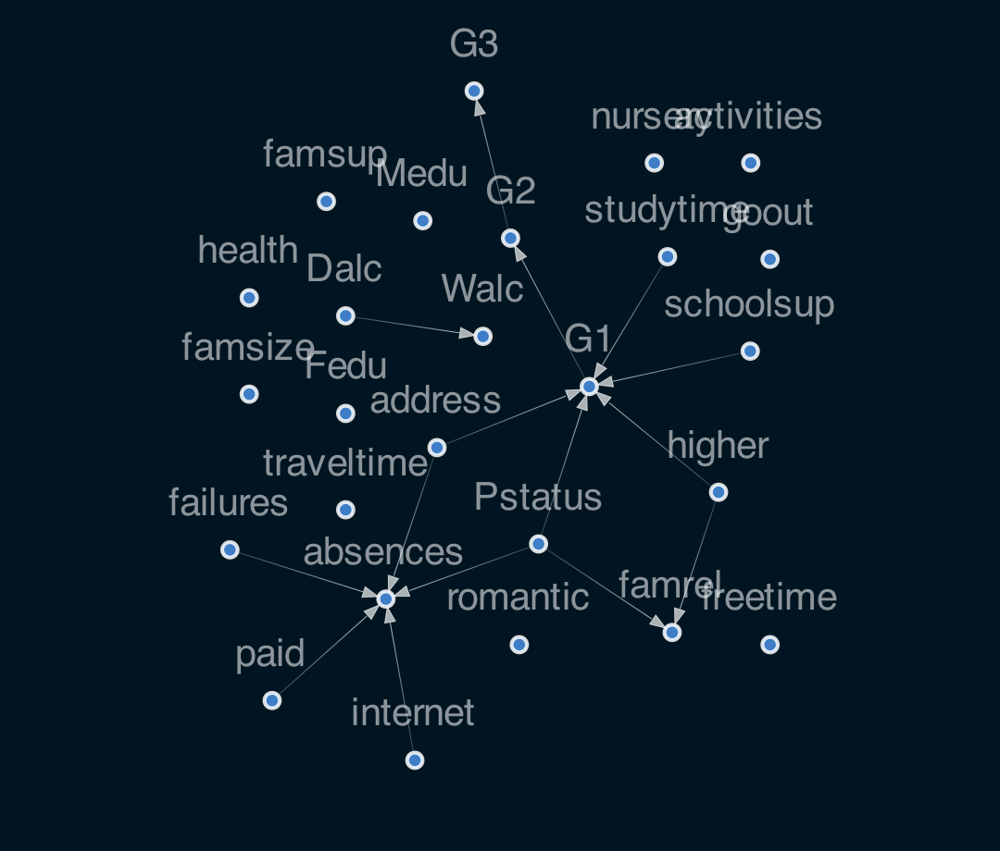

In [15]:
viz = plot_structure(
    sm,
    graph_attributes={"scale": "0.5"},
    all_node_attributes=NODE_STYLE.WEAK,
    all_edge_attributes=EDGE_STYLE.WEAK)
Image(viz.draw(format='png'))

In [16]:
sm.add_edge("failures", "G1")
sm.remove_edge("Pstatus", "G1")
sm.remove_edge("address", "G1")

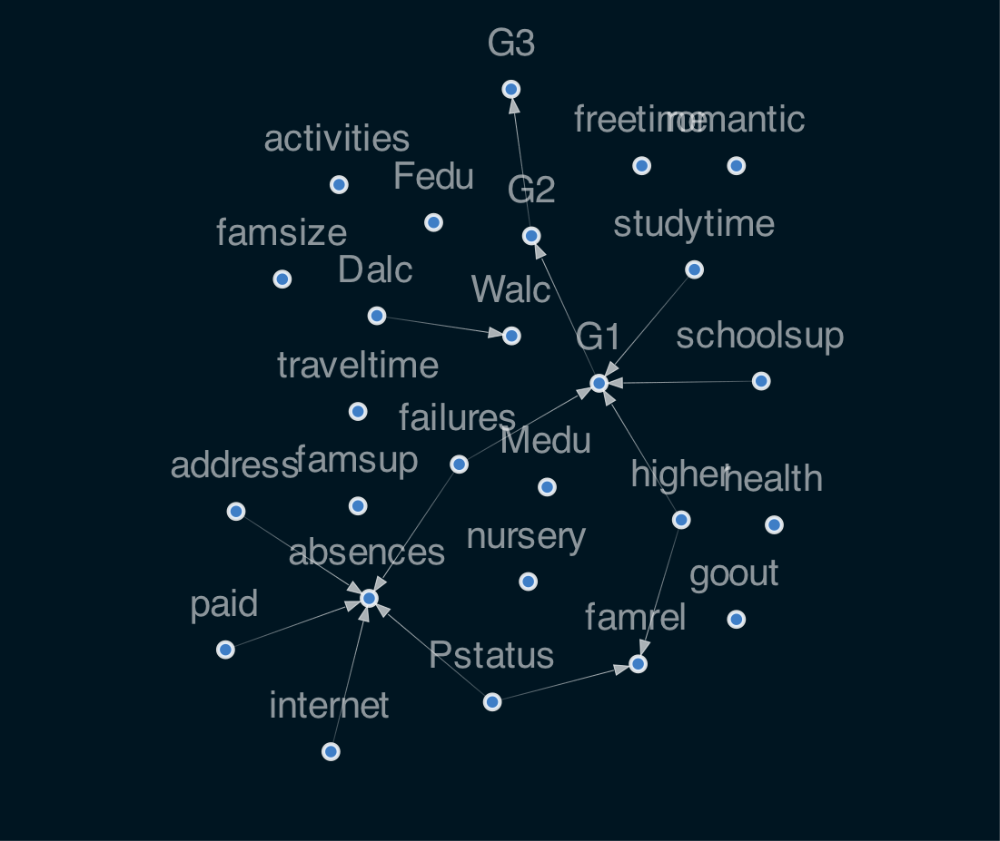

In [17]:
viz = plot_structure(
    sm,
    graph_attributes={"scale": "0.5"},
    all_node_attributes=NODE_STYLE.WEAK,
    all_edge_attributes=EDGE_STYLE.WEAK)
Image(viz.draw(format='png'))

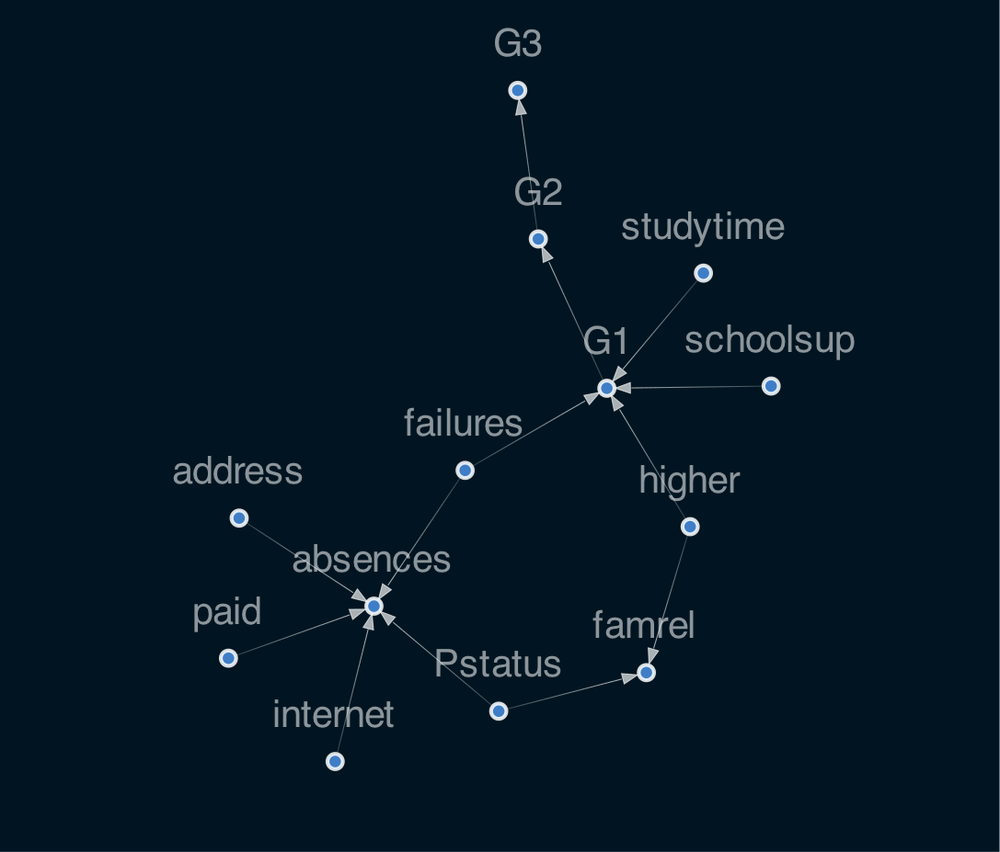

In [18]:
sm = sm.get_largest_subgraph()

viz = plot_structure(
    sm,
    graph_attributes={"scale": "0.5"},
    all_node_attributes=NODE_STYLE.WEAK,
    all_edge_attributes=EDGE_STYLE.WEAK)
Image(viz.draw(format='png'))

dot: Order nodes hierarchly. Great to spot the dependencies of a causal network.


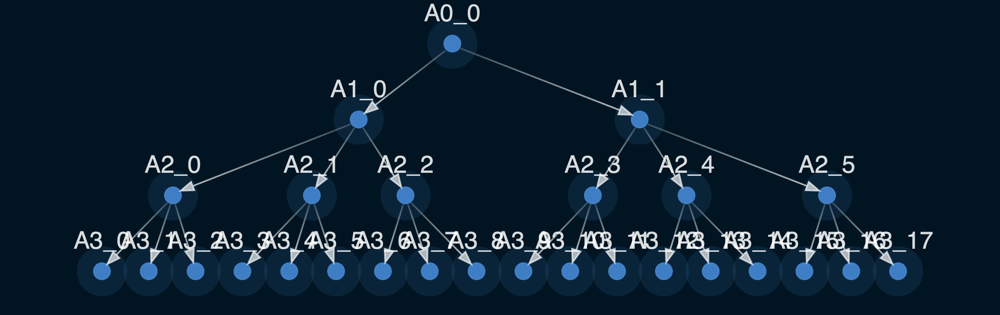

neato: Spring model. Great default tool if the graph is not too large


sfdp: A different style of spring model


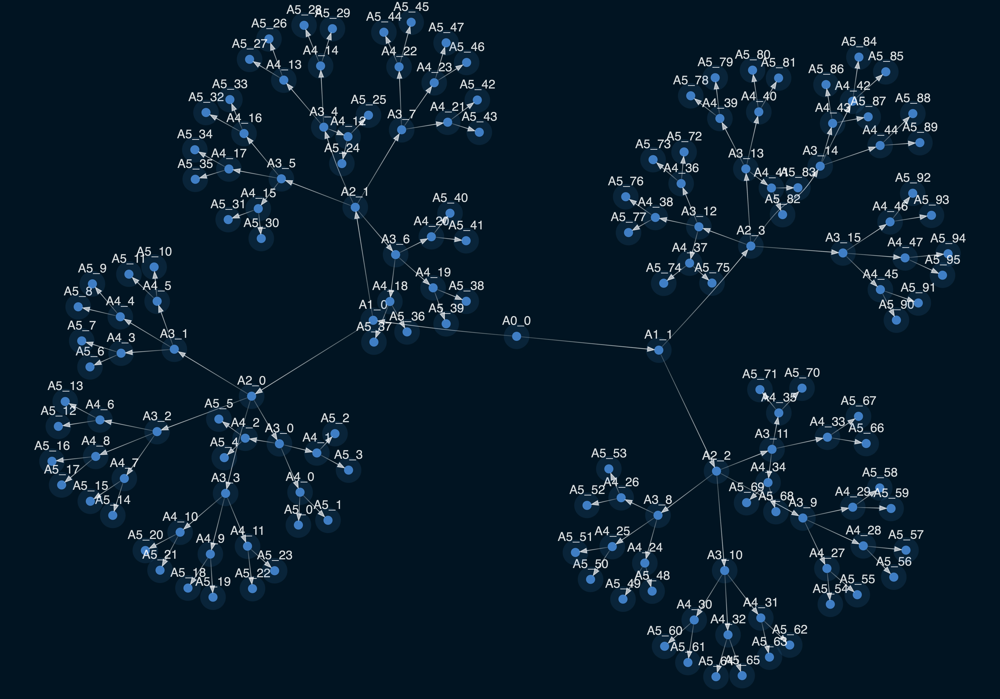

twopi: Radial layout


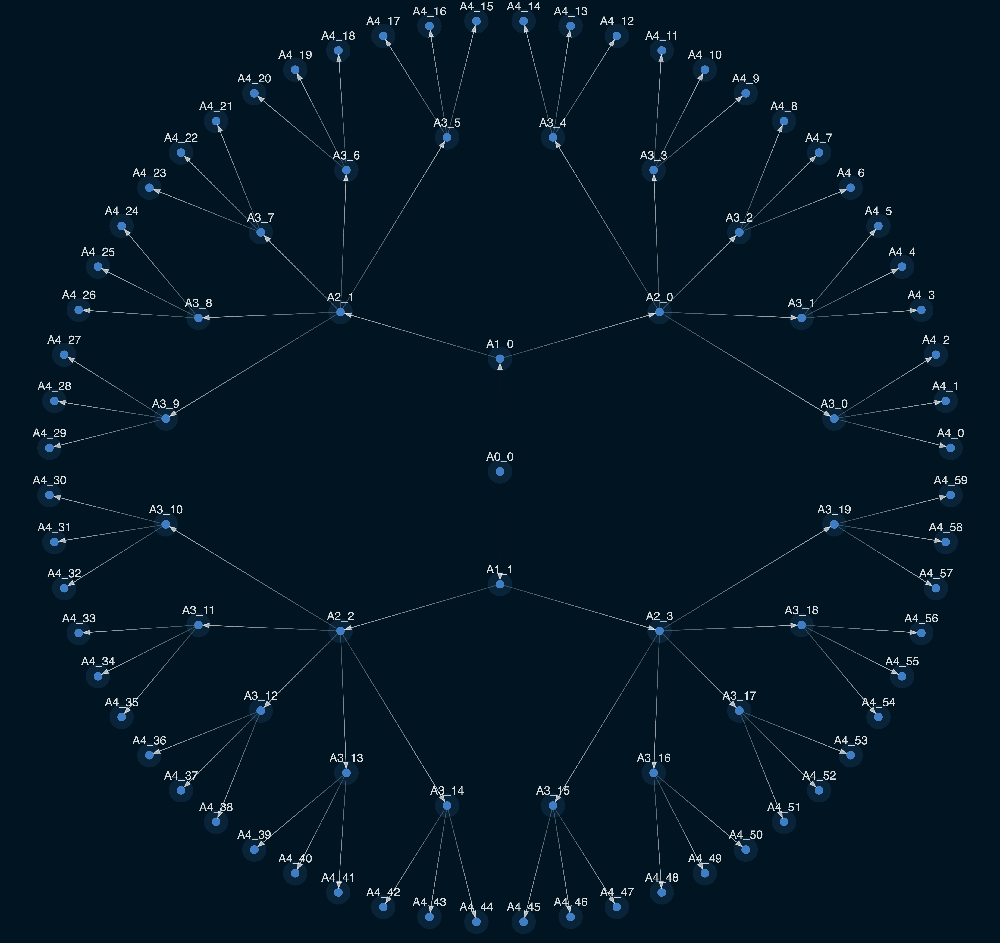

In [19]:
def get_tree(k_list):
    """
    Return the edges of a tree given the number of children at each level
    """
    n = 1
    edges_radial = []
    for level in range(0, len(k_list)):
        k = k_list[level]
        edges_radial.extend(
            [(f"A{level}_{i // k}", f"A{level + 1}_{i}") for i in range(k * n)]
        )
        n = k * n
    return edges_radial


layouts = [
    ("dot","Order nodes hierarchly. Great to spot the dependencies of a causal network.",[2, 3, 3]),
    ("neato", "Spring model. Great default tool if the graph is not too large", [2, 2, 4, 3, 2]),
    ("sfdp", "A different style of spring model", [2, 2, 4, 3, 2]),
    ("twopi", "Radial layout", [2, 2, 5, 3]),
]

for layout, description, k_list in layouts:
    g_tree = StructureModel(get_tree(k_list))
    viz = plot_structure(g_tree)

    print(f"{layout}: {description}")
    image_binary = viz.draw(format="jpg", prog=layout)
    display(Image(image_binary, width=500))

In [20]:
from causalnex.network import BayesianNetwork

bn = BayesianNetwork(sm)

In [21]:
discretised_data = data.copy()

data_vals = {col: data[col].unique() for col in data.columns}

failures_map = {v: 'no-failure' if v == [0]
            else 'have-failure' for v in data_vals['failures']}

studytime_map = {v: 'short-studytime' if v in [1,2]
                 else 'long-studytime' for v in data_vals['studytime']}

In [22]:
discretised_data["failures"] = discretised_data["failures"].map(failures_map)
discretised_data["studytime"] = discretised_data["studytime"].map(studytime_map)

In [23]:
from causalnex.discretiser import Discretiser

discretised_data["absences"] = Discretiser(method="fixed",
                          numeric_split_points=[1, 10]).transform(discretised_data["absences"].values)

discretised_data["G1"] = Discretiser(method="fixed",
                          numeric_split_points=[10]).transform(discretised_data["G1"].values)

discretised_data["G2"] = Discretiser(method="fixed",
                          numeric_split_points=[10]).transform(discretised_data["G2"].values)

discretised_data["G3"] = Discretiser(method="fixed",
                          numeric_split_points=[10]).transform(discretised_data["G3"].values)

In [24]:
absences_map = {0: "No-absence", 1: "Low-absence", 2: "High-absence"}

G1_map = {0: "Fail", 1: "Pass"}
G2_map = {0: "Fail", 1: "Pass"}
G3_map = {0: "Fail", 1: "Pass"}

discretised_data["absences"] = discretised_data["absences"].map(absences_map)
discretised_data["G1"] = discretised_data["G1"].map(G1_map)
discretised_data["G2"] = discretised_data["G2"].map(G2_map)
discretised_data["G3"] = discretised_data["G3"].map(G3_map)

In [25]:
discretised_data.head(10)

,address,famsize,Pstatus,Medu,Fedu,traveltime,studytime,failures,schoolsup,famsup,...,famrel,freetime,goout,Dalc,Walc,health,absences,G1,G2,G3
0,U,GT3,A,4,4,2,short-studytime,no-failure,yes,no,...,4,3,4,1,1,3,Low-absence,Fail,Pass,Pass
1,U,GT3,T,1,1,1,short-studytime,no-failure,no,yes,...,5,3,3,1,1,3,Low-absence,Fail,Pass,Pass
2,U,LE3,T,1,1,1,short-studytime,no-failure,yes,no,...,4,3,2,2,3,3,Low-absence,Pass,Pass,Pass
3,U,GT3,T,4,2,1,long-studytime,no-failure,no,yes,...,3,2,2,1,1,5,No-absence,Pass,Pass,Pass
4,U,GT3,T,3,3,1,short-studytime,no-failure,no,yes,...,4,3,2,1,2,5,No-absence,Pass,Pass,Pass
5,U,LE3,T,4,3,1,short-studytime,no-failure,no,yes,...,5,4,2,1,2,5,Low-absence,Pass,Pass,Pass
6,U,LE3,T,2,2,1,short-studytime,no-failure,no,no,...,4,4,4,1,1,3,No-absence,Pass,Pass,Pass
7,U,GT3,A,4,4,2,short-studytime,no-failure,yes,yes,...,4,1,4,1,1,1,Low-absence,Pass,Pass,Pass
8,U,LE3,A,3,2,1,short-studytime,no-failure,no,yes,...,4,2,2,1,1,1,No-absence,Pass,Pass,Pass
9,U,GT3,T,3,4,1,short-studytime,no-failure,no,yes,...,5,5,1,1,1,5,No-absence,Pass,Pass,Pass


In [26]:
# Split 90% train and 10% test
from sklearn.model_selection import train_test_split

train, test = train_test_split(discretised_data, train_size=0.9, test_size=0.1, random_state=7)

In [27]:
bn = bn.fit_node_states(discretised_data)


In [28]:
bn = bn.fit_cpds(train, method="BayesianEstimator", bayes_prior="K2")


In [29]:
bn.cpds["G1"]


failures    have-failure                                                 \
higher                no                                                  
schoolsup             no                            yes                   
studytime long-studytime short-studytime long-studytime short-studytime   
G1                                                                        
Fail                0.75        0.806452            0.5            0.75   
Pass                0.25        0.193548            0.5            0.25   

failures                                                                 \
higher               yes                                                  
schoolsup             no                            yes                   
studytime long-studytime short-studytime long-studytime short-studytime   
G1                                                                        
Fail                 0.5        0.612245            0.5            0.75   
Pass                 0.5        0.387755            0.5            0.25   

failures      no-failure                                                 \
higher                no                                                  
schoolsup             no                            yes                   
studytime long-studytime short-studytime long-studytime short-studytime   
G1                                                                        
Fail                 0.5        0.612903            0.5             0.5   
Pass                 0.5        0.387097            0.5             0.5   

failures                                                                 
higher               yes                                                 
schoolsup             no                            yes                  
studytime long-studytime short-studytime long-studytime short-studytime  
G1                                                                       
Fail            0.032967         0.15016       0.111111        0.255814  
Pass            0.967033         0.84984       0.888889        0.744186

In [30]:
discretised_data.loc[18, discretised_data.columns != 'G1']


address                     U
famsize                   GT3
Pstatus                     T
Medu                        3
Fedu                        2
traveltime                  1
studytime     short-studytime
failures         have-failure
schoolsup                  no
famsup                    yes
paid                      yes
activities                yes
nursery                   yes
higher                    yes
internet                  yes
romantic                   no
famrel                      5
freetime                    5
goout                       5
Dalc                        2
Walc                        4
health                      5
absences          Low-absence
G2                       Fail
G3                       Fail
Name: 18, dtype: object

In [31]:
predictions = bn.predict(discretised_data, "G1")


In [32]:
print('The prediction is \'{prediction}\''.format(prediction=predictions.loc[18, 'G1_prediction']))


The prediction is 'Fail'


In [33]:
print('The ground truth is \'{truth}\''.format(truth=discretised_data.loc[18, 'G1']))


The ground truth is 'Fail'


In [34]:
from causalnex.evaluation import classification_report
classification_report(bn, test, "G1")

{'G1_Fail': {'precision': 0.7777777777777778,
  'recall': 0.5833333333333334,
  'f1-score': 0.6666666666666666,
  'support': 12},
 'G1_Pass': {'precision': 0.9107142857142857,
  'recall': 0.9622641509433962,
  'f1-score': 0.9357798165137615,
  'support': 53},
 'accuracy': 0.8923076923076924,
 'macro avg': {'precision': 0.8442460317460317,
  'recall': 0.7727987421383649,
  'f1-score': 0.8012232415902141,
  'support': 65},
 'weighted avg': {'precision': 0.8861721611721611,
  'recall': 0.8923076923076924,
  'f1-score': 0.8860973888496825,
  'support': 65}}

In [35]:
from causalnex.evaluation import roc_auc
roc, auc = roc_auc(bn, test, "G1")
print(auc)

0.9181065088757396


In [36]:
bn = bn.fit_cpds(discretised_data, method="BayesianEstimator", bayes_prior="K2")


In [37]:
from causalnex.inference import InferenceEngine

ie = InferenceEngine(bn)
marginals = ie.query()
marginals["G1"]

{'Fail': 0.25260687281677224, 'Pass': 0.7473931271832277}

In [38]:
import numpy as np
labels, counts = np.unique(discretised_data["G1"], return_counts=True)
list(zip(labels, counts))

[('Fail', 157), ('Pass', 492)]

In [39]:
marginals_short = ie.query({"studytime": "short-studytime"})
marginals_long = ie.query({"studytime": "long-studytime"})
print("Marginal G1 | Short Studtyime", marginals_short["G1"])
print("Marginal G1 | Long Studytime", marginals_long["G1"])

Marginal G1 | Short Studtyime {'Fail': 0.2776556433482524, 'Pass': 0.7223443566517477}
Marginal G1 | Long Studytime {'Fail': 0.15504850337837614, 'Pass': 0.8449514966216239}


In [40]:
print("distribution before do", ie.query()["higher"])
ie.do_intervention("higher",
                   {'yes': 1.0,
                    'no': 0.0})
print("distribution after do", ie.query()["higher"])

distribution before do {'no': 0.10752688172043011, 'yes': 0.8924731182795698}
distribution after do {'no': 0.0, 'yes': 0.9999999999999998}


In [41]:
ie.reset_do("higher")


In [42]:
print("marginal G1", ie.query()["G1"])
ie.do_intervention("higher",
                   {'yes': 1.0,
                    'no': 0.0})
print("updated marginal G1", ie.query()["G1"])

marginal G1 {'Fail': 0.25260687281677224, 'Pass': 0.7473931271832277}
updated marginal G1 {'Fail': 0.20682952942551894, 'Pass': 0.7931704705744809}


# Customization with CausalNex

In [43]:
import numpy as np
from causalnex.structure import StructureModel
from causalnex.plots import plot_structure
from IPython.display import Image

import warnings

warnings.filterwarnings("ignore")

from itertools import chain

edges = [
    ("Age", "SocioEcon", {"weight": 0.37}),
    ("SocioEcon", "OtherCar", {"weight": 0.95}),
    ("SocioEcon", "GoodStudent", {"weight": 0.73}),
    ("Age", "GoodStudent", {"weight": 0.6}),
    ("SocioEcon", "RiskAversion", {"weight": 0.16}),
    ("Age", "RiskAversion", {"weight": 0.16}),
    ("RiskAversion", "VehicleYear", {"weight": 0.06}),
    ("SocioEcon", "VehicleYear", {"weight": 0.87}),
    ("Accident", "ThisCarDam", {"weight": 0.6}),
    ("RuggedAuto", "ThisCarDam", {"weight": 0.71}),
    ("MakeModel", "RuggedAuto", {"weight": 0.02}),
    ("VehicleYear", "RuggedAuto", {"weight": 0.97}),
    ("Mileage", "Accident", {"weight": 0.83}),
    ("DrivQuality", "Accident", {"weight": 0.21}),
    ("Antilock", "Accident", {"weight": 0.18}),
    ("RiskAversion", "MakeModel", {"weight": 0.18}),
    ("SocioEcon", "MakeModel", {"weight": 0.3}),
    ("RiskAversion", "DrivQuality", {"weight": 0.52}),
    ("DrivingSkill", "DrivQuality", {"weight": 0.43}),
    ("MakeModel", "Antilock", {"weight": 0.29}),
    ("VehicleYear", "Antilock", {"weight": 0.61}),
    ("SeniorTrain", "DrivingSkill", {"weight": 0.14}),
    ("Age", "DrivingSkill", {"weight": 0.29}),
    ("RiskAversion", "SeniorTrain", {"weight": 0.37}),
    ("Age", "SeniorTrain", {"weight": 0.46}),
    ("Theft", "ThisCarCost", {"weight": 0.79}),
    ("CarValue", "ThisCarCost", {"weight": 0.2}),
    ("ThisCarDam", "ThisCarCost", {"weight": 0.51}),
    ("HomeBase", "Theft", {"weight": 0.59}),
    ("AntiTheft", "Theft", {"weight": 0.05}),
    ("CarValue", "Theft", {"weight": 0.61}),
    ("Mileage", "CarValue", {"weight": 0.17}),
    ("MakeModel", "CarValue", {"weight": 0.07}),
    ("VehicleYear", "CarValue", {"weight": 0.95}),
    ("RiskAversion", "HomeBase", {"weight": 0.97}),
    ("SocioEcon", "HomeBase", {"weight": 0.81}),
    ("RiskAversion", "AntiTheft", {"weight": 0.3}),
    ("SocioEcon", "AntiTheft", {"weight": 0.1}),
    ("OtherCarCost", "PropCost", {"weight": 0.68}),
    ("ThisCarCost", "PropCost", {"weight": 0.44}),
    ("Accident", "OtherCarCost", {"weight": 0.12}),
    ("RuggedAuto", "OtherCarCost", {"weight": 0.5}),
    ("Accident", "MedCost", {"weight": 0.03}),
    ("Cushioning", "MedCost", {"weight": 0.91}),
    ("Age", "MedCost", {"weight": 0.26}),
]
g = StructureModel(edges)

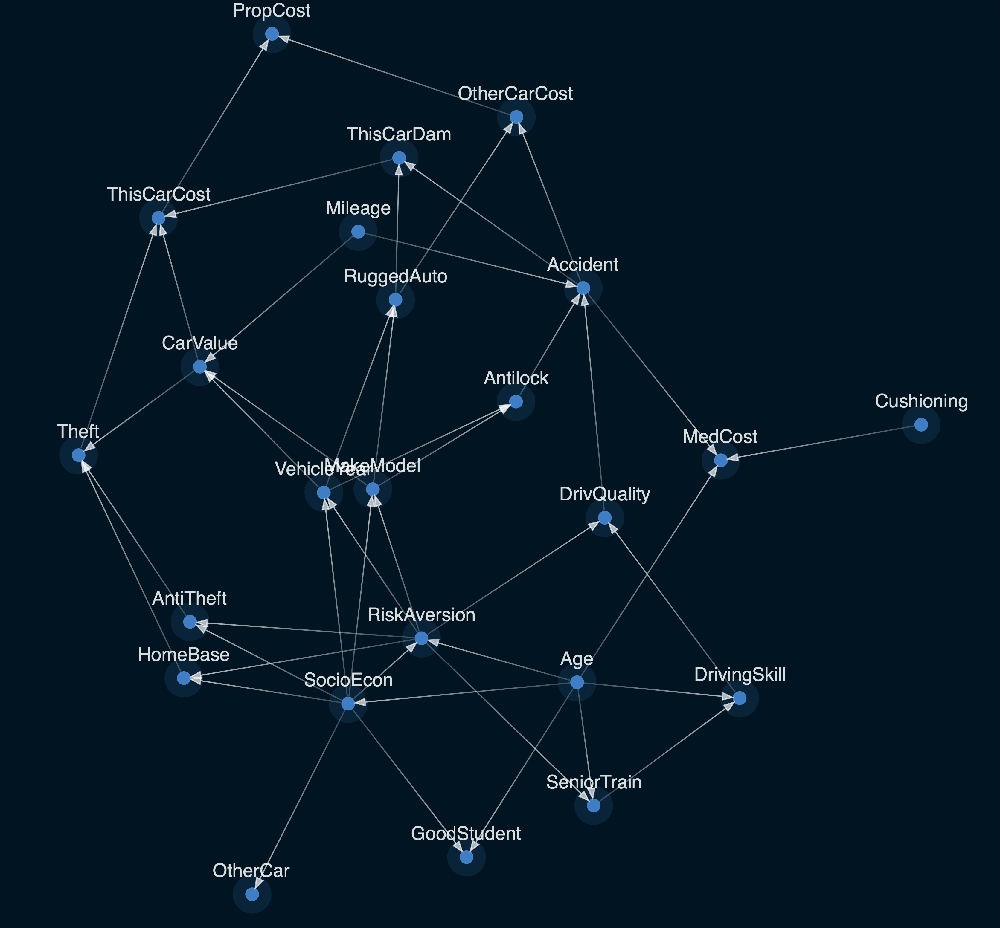

In [44]:
viz = plot_structure(g)  # Default CausalNex visualisation
image_binary = viz.draw(format="jpg")
Image(image_binary)

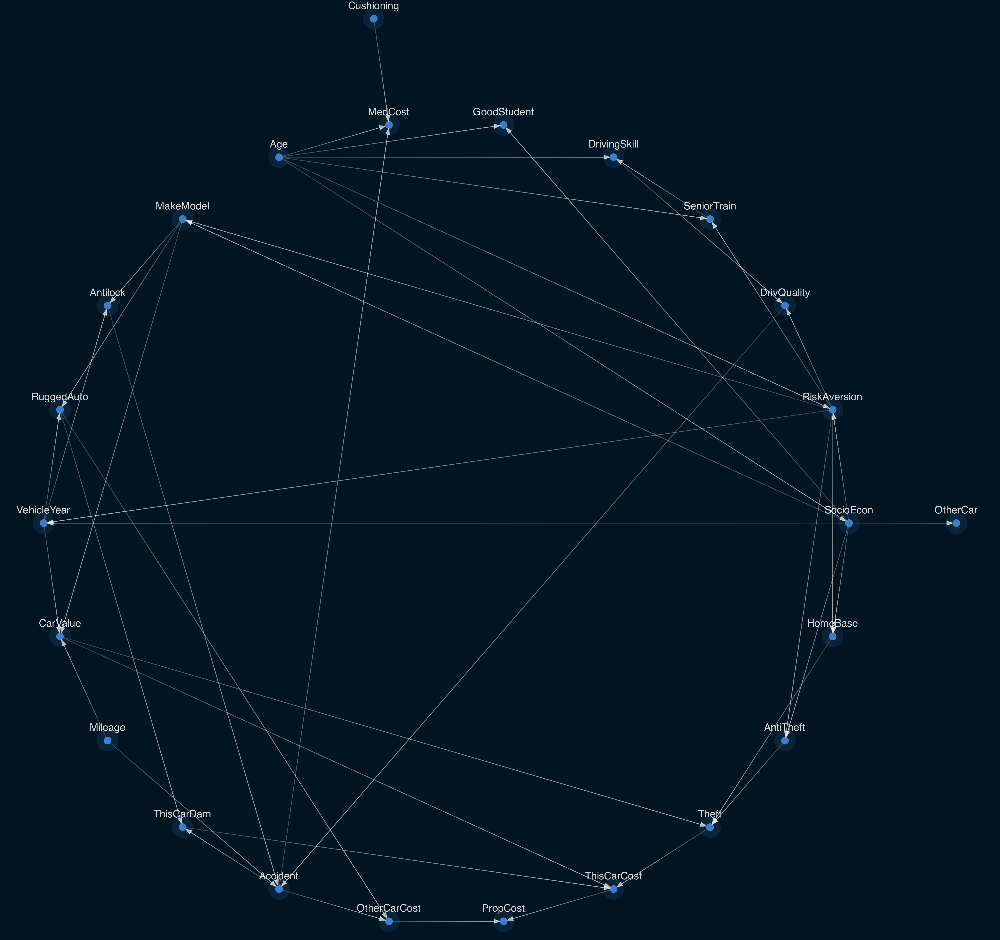

In [45]:
Image(viz.draw(
    format="png", prog="circo"  # `circo` produces a circular layout
),width=500)

dot: Order nodes hierarchly. Great to spot the dependencies of a causal network.


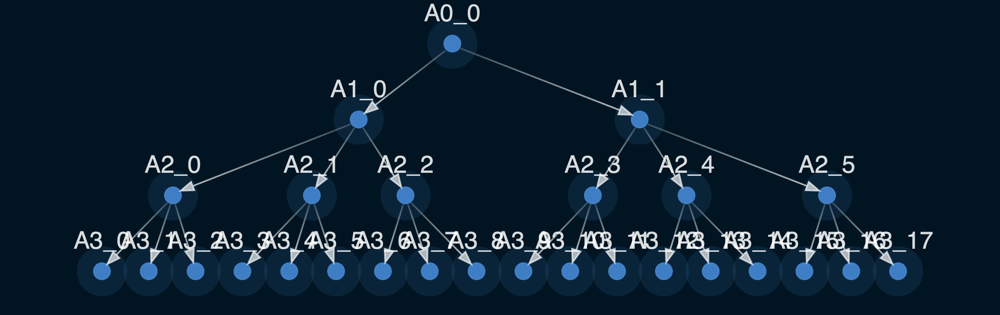

neato: Spring model. Great default tool if the graph is not too large


sfdp: A different style of spring model


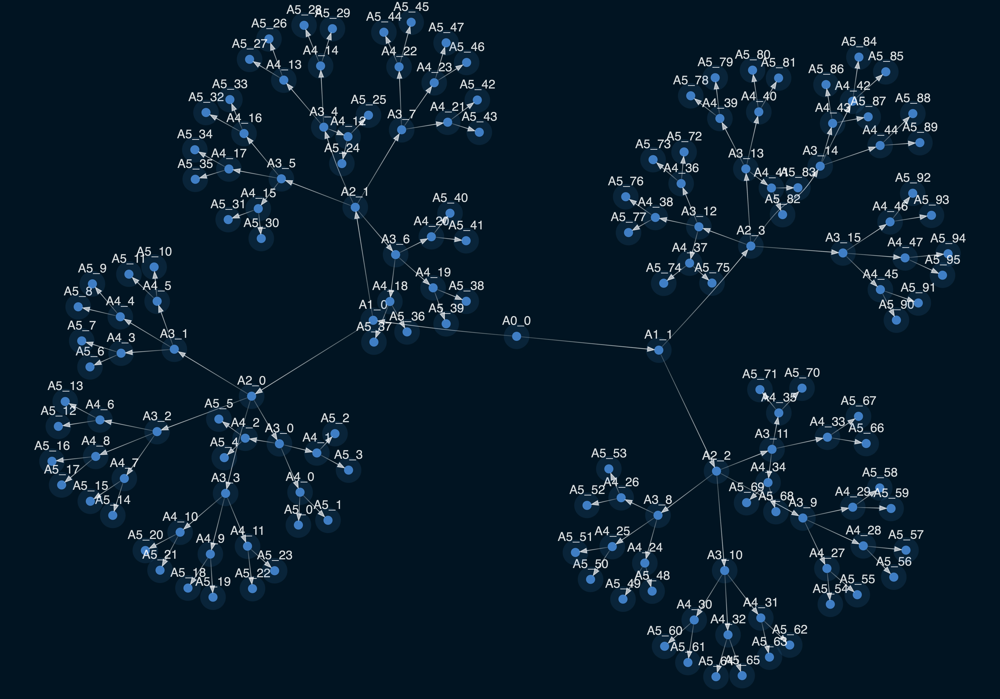

twopi: Radial layout


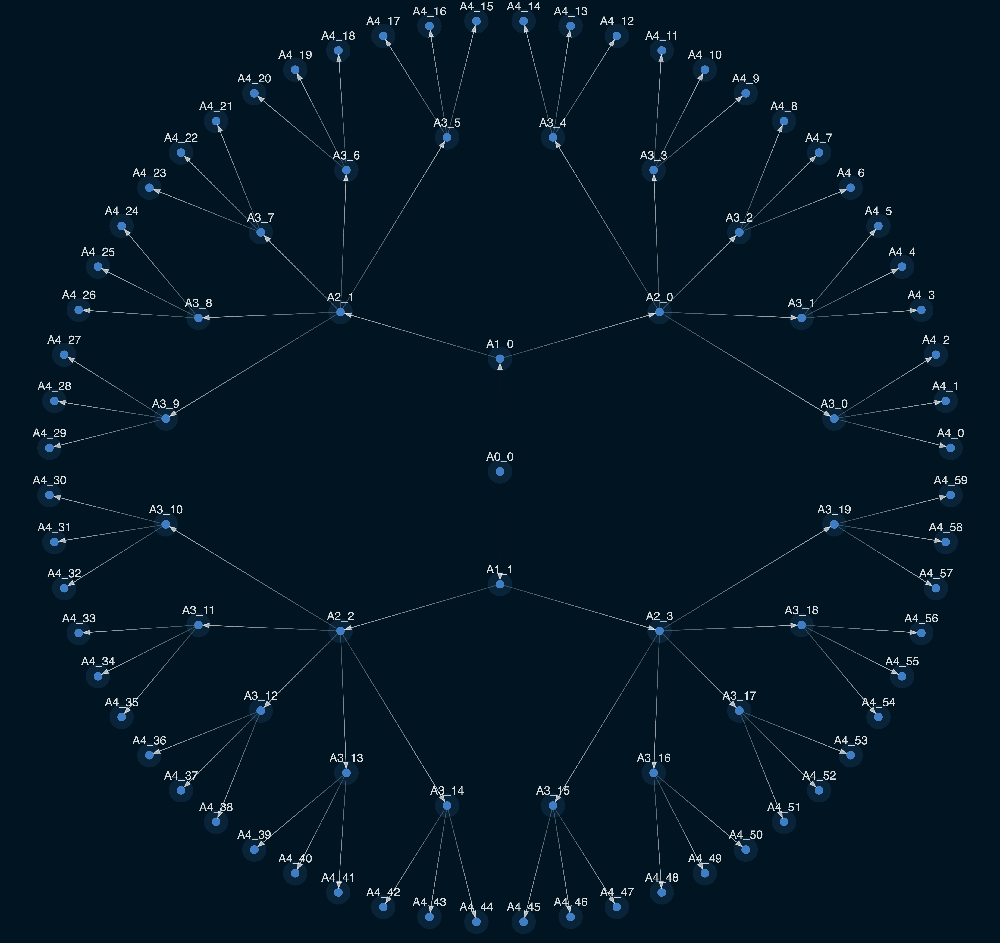

In [46]:
def get_tree(k_list):
    """
    Return the edges of a tree given the number of children at each level
    """
    n = 1
    edges_radial = []
    for level in range(0, len(k_list)):
        k = k_list[level]
        edges_radial.extend(
            [(f"A{level}_{i // k}", f"A{level + 1}_{i}") for i in range(k * n)]
        )
        n = k * n
    return edges_radial


layouts = [
    ("dot","Order nodes hierarchly. Great to spot the dependencies of a causal network.",[2, 3, 3]),
    ("neato", "Spring model. Great default tool if the graph is not too large", [2, 2, 4, 3, 2]),
    ("sfdp", "A different style of spring model", [2, 2, 4, 3, 2]),
    ("twopi", "Radial layout", [2, 2, 5, 3]),
]

for layout, description, k_list in layouts:
    g_tree = StructureModel(get_tree(k_list))
    viz = plot_structure(g_tree)

    print(f"{layout}: {description}")
    image_binary = viz.draw(format="jpg", prog=layout)
    display(Image(image_binary, width=500))

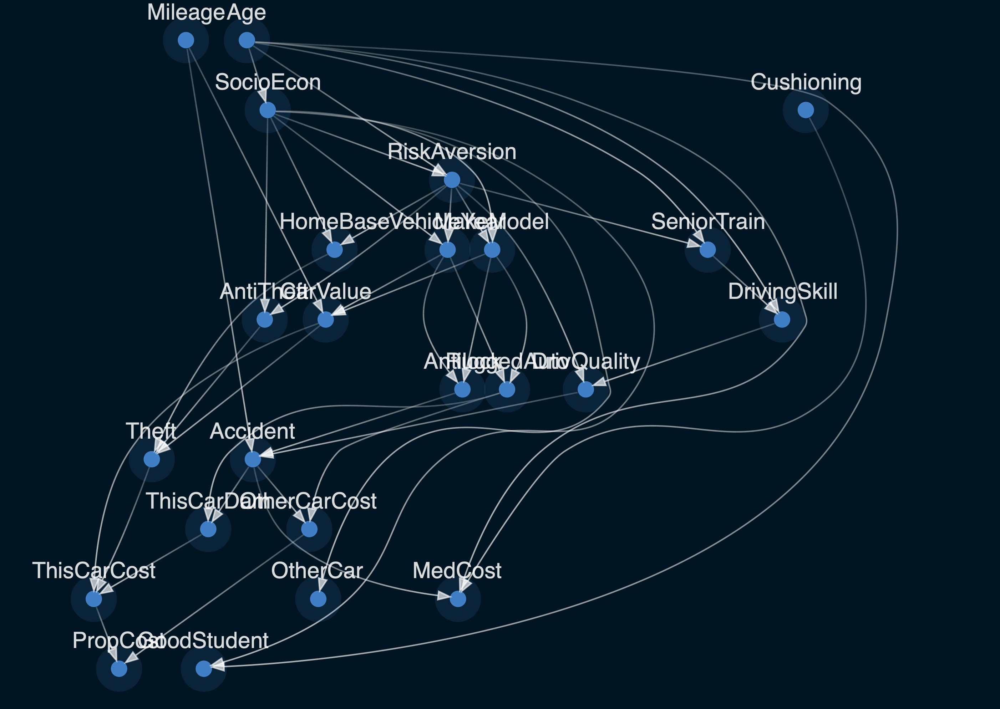

In [47]:
viz = plot_structure(g, prog="dot")
Image(viz.draw(format="jpg"))

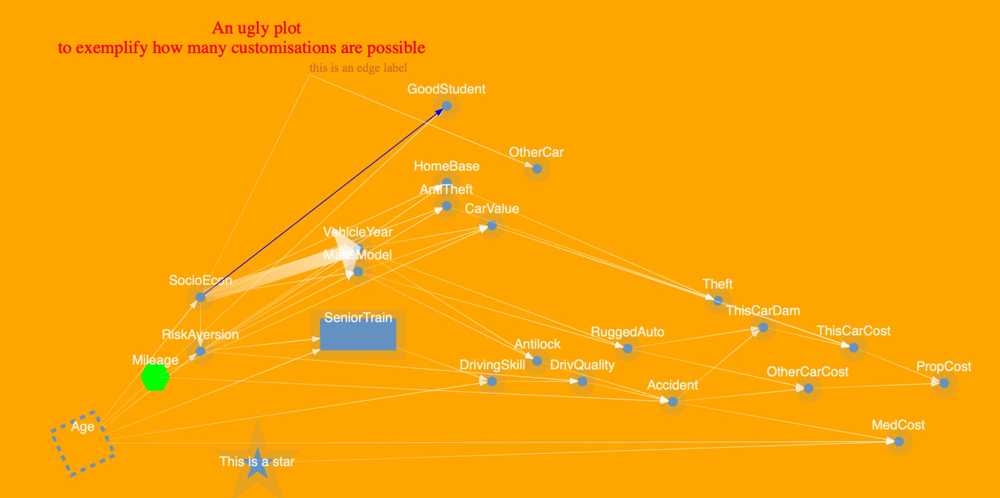

In [48]:
graph_attributes = {
    "rankdir": "LR",  # Change ranking direction to be horizontal
    "splines": "false",  # Do not curve edges, use straight lines instead
    "bgcolor": "orange",  # background color
    "label": "An ugly plot\nto exemplify how many customisations are possible",
    "fontcolor": "red",  # Setting label font
    "fontname": "Times",  # Setting label font settings
    "fontsize": 20,  # Setting LABEL font settings
    "pad": "0.8,0.3",  # setting a margin
    "dpi": 120,  # resolution
    "labeljust": "l",  # This sets the title to be at the left
    "labelloc": "t",  # This sets the title to be at the top
    "nodesep": 0.2,  # separation between nodes with same rank
    "ranksep": 1.1,  # This changes the distances between rank levels in hierarchy (For Dot and twopi only )
}

# Changing attributes of specific nodes
node_attributes = {
    "Age": {  # We change the attributes of the node "Age"
        "shape": "square",
        "style": "dashed",
        "width": 1,
        "penwidth": "4",  # Thickness of the boundary
        "color": "#4a90e2d9",
        "orientation": 25,  # rotate node
    },
    "Mileage": {
        "shape": "hexagon",
        "regular": "true",  # forces the polygon to be regular
        "color": "green",
    },
    "Cushioning": {
        "shape": "star",
        "label": "This is a star",  # Label overwrites the default nae
    },
    "SeniorTrain": {
        "image": "./supporting_files/cat.jpeg",  # we can upload local images inside a node
        "width": 1.2,
        "shape": "dot",  # choose node to be a dot, so that the image is larger than the node
    },
}

# Changing attributes of specific edges
edge_attributes = {
    ("SocioEcon", "OtherCar"): {
        "label": "this is an edge label",  # Edges can have labels
        "fontcolor": "chocolate",  # setting the label color
    },
    ("SocioEcon", "GoodStudent"): {"color": "blue"},
    ("SocioEcon", "RiskAversion"): {
        "constraint": "false"
    },  # edge not used for ranking, both extremities are on same level
    ("SocioEcon", "VehicleYear"): {"penwidth": 15},  # Thickness of edge
}


viz = plot_structure(
    g,
    prog="dot",
    graph_attributes=graph_attributes,
    node_attributes=node_attributes,
    edge_attributes=edge_attributes,
)
display(Image(viz.draw(format="jpg")))

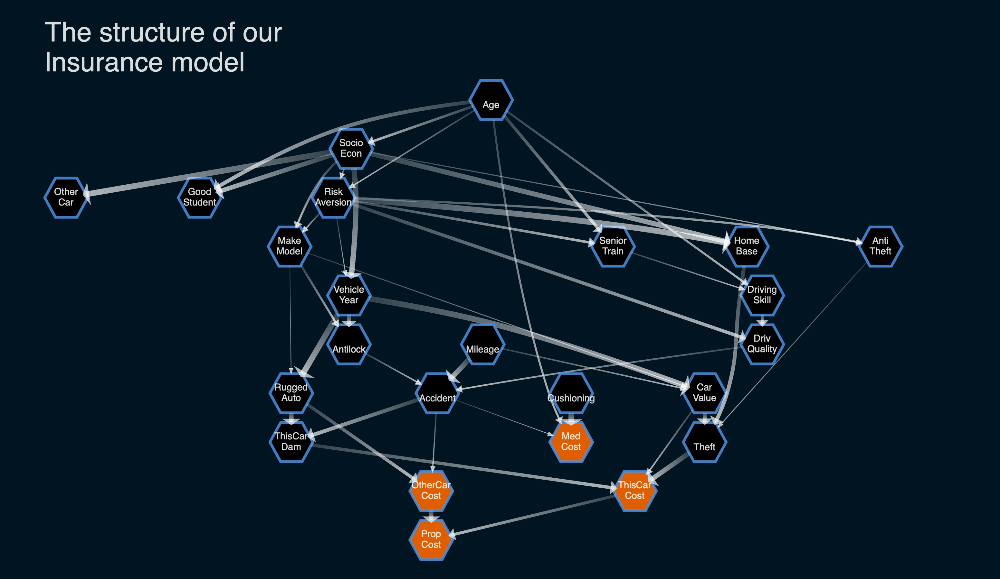

In [49]:
graph_attributes = {
    "splines": "spline",  # I use splies so that we have no overlap
    "ordering": "out",
    "ratio": "fill",  # This is necessary to control the size of the image
    "size": "16,9!",  # Set the size of the final image. (this is a typical presentation size)
    "label": "The structure of our\n \t Insurance model",
    "fontcolor": "#FFFFFFD9",
    "fontname": "Helvetica",
    "fontsize": 100,
    "labeljust": "l",
    "labelloc": "t",
    "pad": "1,1",
    "dpi": 200,
    "nodesep": 0.8,
    "ranksep": ".5 equally",
}

# Making all nodes hexagonal with black coloring
node_attributes = {
    node: {
        "shape": "hexagon",
        "width": 2.2,
        "height": 2,
        "fillcolor": "#000000",
        "penwidth": "10",
        "color": "#4a90e2d9",
        "fontsize": 35,
        "labelloc": "c",
    }
    for node in g.nodes
}

# Splitting two words with "\n"
for node in g.nodes:
    up_idx = [i for i, c in enumerate(node) if c.isupper()][-1]
    node_attributes[node]["label"] = node[:up_idx] + "\n" + node[up_idx:]

# Target nodes (ones with "Cost" in the name) are colored differently
for node in g.nodes:
    if "Cost" in node:  # We color nodes with "cost" in the name with a orange colour.
        node_attributes[node]["fillcolor"] = "#DF5F00"

# Customising edges
edge_attributes = {
    (u, v): {
        "penwidth": w * 20 + 2,  # Setting edge thickness
        "weight": int(5 * w),  # Higher "weight"s mean shorter edges
        "arrowsize": 2 - 2.0 * w,  # Avoid too large arrows
        "arrowtail": "dot",
    }
    for u, v, w in g.edges(data="weight")
}


viz = plot_structure(
    g,
    prog="dot",
    graph_attributes=graph_attributes,
    node_attributes=node_attributes,
    edge_attributes=edge_attributes,
)
f = "final_insurance_model.jpg"
viz.draw(f)
Image(f)

In [50]:
del graph_attributes["size"]
del graph_attributes["ratio"]

# minor changes on distancing
graph_attributes["nodesep"] = 2
graph_attributes["ranksep"] = "1.1 equally"
graph_attributes["label"] = "This is the structure if size is\nnot fixed"

viz = plot_structure(
    g,
    prog="dot",
    graph_attributes=graph_attributes,
    node_attributes=node_attributes,
    edge_attributes=edge_attributes,
)
display(Image(viz.draw(format="jpg")))

Graph with with no clusters


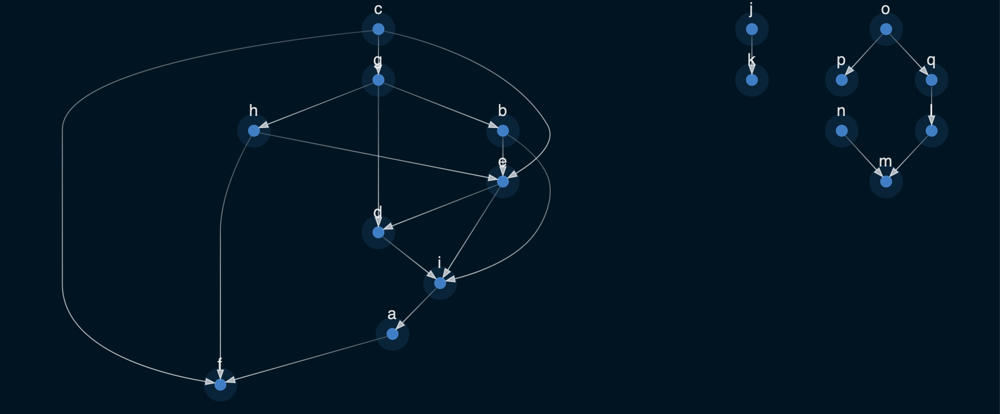

Graph with clusters and subgraphs added


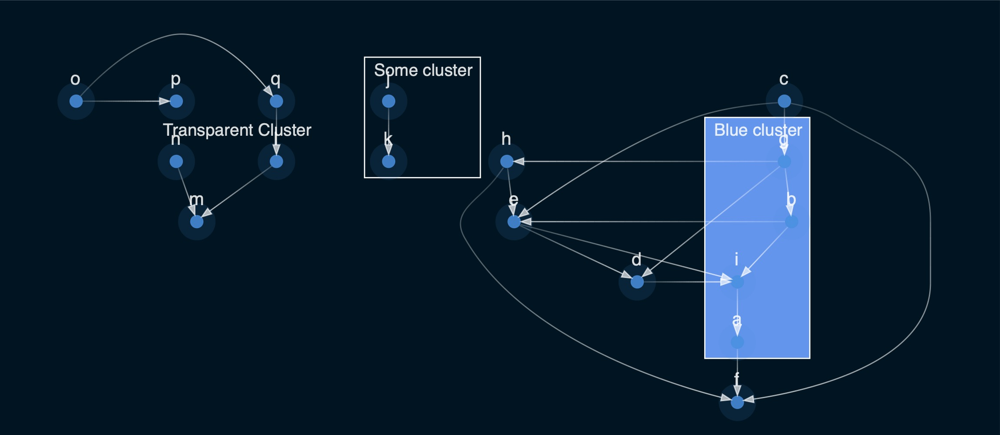

In [51]:
g_test = StructureModel(    [
        ("g", "d"),
        ("h", "e"),
        ("g", "h"),
        ("e", "d"),
        ("c", "f"),
        ("h", "f"),
        ("b", "e"),
        ("a", "f"),
        ("i", "a"),
        ("d", "i"),
        ("c", "e"),
        ("c", "g"),
        ("e", "i"),
        ("g", "b"),
        ("d", "i"),
        ("b", "i"),
        ("j", "k"),
        ("l", "m"),
        ("n", "m"),
        ("n", "m"),
        ("o", "p"),
        ("o", "q"),
        ("q", "l"),
    ]
)

viz = plot_structure(
    g_test,
    prog="dot",
    graph_attributes={"dpi": 200, "nodesep": 1, "ranksep": ".5 equally"},
)

print("Graph with with no clusters")
display(Image(viz.draw(format="jpg")))


print("Graph with clusters and subgraphs added")
# This Subgraph sets the nodes 'o','p','q' to have the same rank, i.e. be on the same level
subgraph = viz.subgraph(["o", "p", "q"], name="same_level_subraph")
subgraph.graph_attr.update({"rank": "same"})
# This is a cluster, since the name starts with "cluster". Note the white retangular box around it
subgraph = viz.subgraph(["j", "k"], name="cluster_1", label="Some cluster")
subgraph.graph_attr.update({"color": "white"})
# A cluster with background color different from the rest of the graph
subgraph = viz.subgraph(["g", "b", "i", "a"], name="cluster2", label="Blue cluster")
subgraph.graph_attr.update({"color": "white", "bgcolor": "cornflowerblue"})
# Another cluster, this time transparent
subgraph = viz.subgraph(["l", "m", "n"], name="cluster3", label="Transparent Cluster")
subgraph.graph_attr.update({"color": "transparent"})

## It is important to run this before `draw` to get the desired effect
viz.layout("dot")
display(Image(viz.draw(format="jpg")))

In [52]:
# digraph G {
#     graph [dpi=100];
#     a [color=blue, shape=cylinder]
#     a -> b[color=red];
#     a -> c;
# }

In [53]:
# dot -Tjpg simple_graph.dot > output.jpg


In [54]:
#https://gist.githubusercontent.com/Coronavirus-20/ecbb27016122e91ab4a273195d89b0d9/raw/b3ce86ddfa4a93391dd1a08400277bea51a5f386/Coronavirus_17Apr.csv